**Базовые преобразования**

Auto-Orient: Включить

Resize: 1280x1280 (сохраняем размер тайлов)

---
**Улучшение качества**

Auto-Adjust Contrast: Включить (улучшит различимость границ участков)

---
**Аугментации**

Rotation: ±15° (учитывает возможные различия в ориентации участков)

Brightness: ±15% (компенсирует различия в освещении)

Exposure: ±15% (улучшает работу с затененными участками)

Noise: До 2% (повышает устойчивость модели)

# Обучение моделей

In [1]:
!pip install numpy matplotlib gdal ultralytics roboflow tifffile pillow opencv-python-headless

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 904.4/904.4 kB 19.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.5/81.5 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 3.7 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from osgeo import gdal
from ultralytics import YOLO
from roboflow import Roboflow
from tifffile import imread

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
from roboflow import Roboflow
import json

def read_roboflow_config(config_file='config.txt'):
    with open(config_file, 'r') as f:
        config = json.load(f)
    return config

def init_roboflow(path):
    config = read_roboflow_config(path)
    rf = Roboflow(api_key=config['api_key'])
    project = rf.workspace(config['workspace']).project(config['project'])
    return project

project = init_roboflow("/kaggle/input/config/config.txt")

loading Roboflow workspace...
loading Roboflow project...


In [4]:
# После разметки загрузим датасет
dataset = project.version(2).download("yolov8")

# Подготовка конфигурационного файла
with open("agri_data.yaml", "w") as f:
    f.write(f"path: {dataset.location}\n")
    f.write("train: train/images\n")
    f.write("val: valid/images\n")
    f.write("test: test/images\n")
    f.write("nc: 1\n")
    f.write("names: ['agricultural_land']\n")



Extracting Dataset Version Zip to test-task-2 in yolov8:: 100%|██████████| 2412/2412 [00:01<00:00, 2074.52it/s]


In [5]:
model_v8 = YOLO("/kaggle/input/try1/other/default/1/last.pt")
v8_metrics = model_v8.val(data="agri_data.yaml")


Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n-seg summary (fused): 195 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 24.2MB/s]
val: Scanning /kaggle/working/test-task-2/valid/labels... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<00:00, 693.31it/s]

val: New cache created: /kaggle/working/test-task-2/valid/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.45s/it]


                   all         75        382      0.608      0.652      0.678      0.452      0.573      0.621      0.618      0.398
Speed: 15.4ms preprocess, 20.5ms inference, 0.0ms loss, 5.7ms postprocess per image
Results saved to runs/segment/val


In [6]:
# model_v8 = YOLO("yolov8n-seg.yaml")
# results_v8 = model_v8.train(data="agri_data.yaml", epochs=100, imgsz=1280, batch=16, device=0, workers=4, save_period=10)
# v8_metrics = model_v8.val()
# # workers 0 save best weights early stopping

In [7]:
# Загрузка обученной модели
model_v11 = YOLO('/kaggle/input/try1/tensorflow2/jk/1/best11.pt')

# Валидация загруженной модели
v11_metrics = model_v11.val(data="agri_data.yaml")

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n-seg summary (fused): 265 layers, 2,834,763 parameters, 0 gradients, 10.2 GFLOPs


val: Scanning /kaggle/working/test-task-2/valid/labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.38s/it]


                   all         75        382      0.609      0.623      0.648      0.426      0.555      0.602      0.573      0.369
Speed: 16.9ms preprocess, 20.7ms inference, 0.1ms loss, 3.6ms postprocess per image
Results saved to runs/segment/val2


In [8]:
# # Загрузка модели, сохраненной на 40 эпохе
# model_v11 = YOLO("/kaggle/input/try1/other/default/1/epoch40.pt")

# # Продолжение обучения
# results_v11 = model_v11.train(
#     data="agri_data.yaml",  # Путь к файлу с данными
#     epochs=100,             # Общее количество эпох (например, 100)
#     imgsz=1280,
#     batch=16,
#     device=0,
#     workers=4,
#     save_period=10,
#     resume=True             # Продолжить обучение с последнего чекпоинта
# )

# # Валидация модели
# v11_metrics = model_v11.val()

In [9]:
import pandas as pd
metrics_df = pd.DataFrame({
    'Metric': ['Precision', 'Recall', 'mAP50', 'mAP50-95'],
    'YOLOv8': [v8_metrics.seg.p, v8_metrics.seg.r, v8_metrics.seg.map50, v8_metrics.seg.map],
    'YOLOv11': [v11_metrics.seg.p, v11_metrics.seg.r, v11_metrics.seg.map50, v11_metrics.seg.map]
})

print(metrics_df)

      Metric                YOLOv8               YOLOv11
0  Precision  [0.5725788886919383]  [0.5554214753430655]
1     Recall  [0.6207113743627343]  [0.6017680784359781]
2      mAP50               0.61768              0.573073
3   mAP50-95              0.397642                0.3693


Yolo 8 чуть лучше справляется по кажой метрике.

В целом метрика mAP50 получилась не такой уж плохой. Моделька, по карйне мере, отрабатывает лучше, чем непредобученная 

Не очень высокие показатели, скорее всего, вышли по нескольким причинам:
1. Сложность данных
   - Большая вариативность форм и размеров
   - Не всегда поянтные границы
2. В связи с первым пунктом, думаю, стоит сказать, что есть сложность разметки (я, честно, далеко не всегда был уверен в своей разметке)
3. Недостаточное количество размеченных изображений
4. Возмодно, стоит поработать с преобразованиями, так как довольно сомнительно брать -15% яркость и еще -15% экспозиции (некоторые изображения совсем темными становятся), т.е. проводя дальше исследование, я бы совершил еще эксперименты с преобразованиями

Кратко, что можно сделать для улучшения результатов:
1. Увеличить качество разметки
2. Увеличить датасет
3. Провести эксперименты с аугментацией данных
4. Использовать другие модели (U-Net, DeepLab, Mask R-CNN)


### Берем 20 изображений из тестовой выборки для просмотора работы модели на изображениях

In [10]:
test_images_dir = "/kaggle/working/test-task-2/test/images"

# Получение списка первых 20 изображений
image_files = sorted([f for f in os.listdir(test_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))])[:20]

# Получение списка изображений с 20 по 40
image_files2 = sorted([f for f in os.listdir(test_images_dir) if f.endswith(('.png', '.jpg', '.jpeg'))])[20:40]


image 1/1 /kaggle/working/test-task-2/test/images/tile_15360_33280_png.rf.acbde1eab5b48744fc6932ca275d82b3.jpg: 1280x1280 25 agricultural_lands, 25.7ms
Speed: 6.6ms preprocess, 25.7ms inference, 14.1ms postprocess per image at shape (1, 3, 1280, 1280)

image 1/1 /kaggle/working/test-task-2/test/images/tile_15360_33280_png.rf.acbde1eab5b48744fc6932ca275d82b3.jpg: 1280x1280 7 agricultural_lands, 25.8ms
Speed: 5.2ms preprocess, 25.8ms inference, 8.4ms postprocess per image at shape (1, 3, 1280, 1280)

image 1/1 /kaggle/working/test-task-2/test/images/tile_15360_33280_png.rf.acbde1eab5b48744fc6932ca275d82b3.jpg: 1280x1280 20 agricultural_lands, 27.6ms
Speed: 5.4ms preprocess, 27.6ms inference, 3.9ms postprocess per image at shape (1, 3, 1280, 1280)

image 1/1 /kaggle/working/test-task-2/test/images/tile_15360_33280_png.rf.acbde1eab5b48744fc6932ca275d82b3.jpg: 1280x1280 9 agricultural_lands, 27.6ms
Speed: 5.5ms preprocess, 27.6ms inference, 2.8ms postprocess per image at shape (1, 3, 1280,

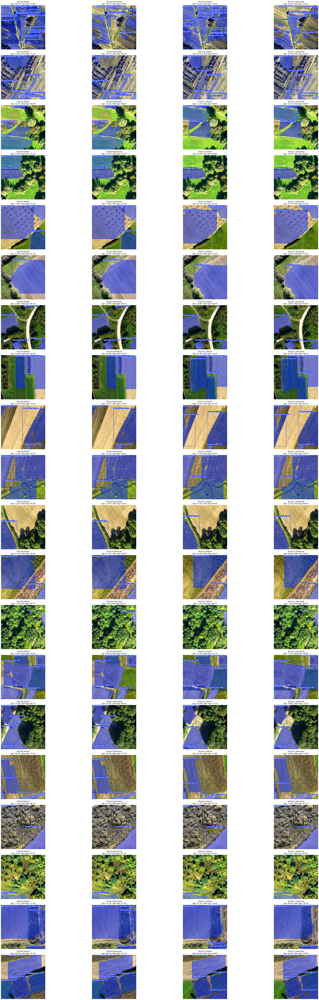

In [11]:
import cv2

def calculate_area_percentage(masks):
    if masks is None or len(masks) == 0:
        return 0
    # Объединяем все маски в одну
    combined_mask = np.max(masks.data.cpu().numpy(), axis=0)
    # Подсчитываем процент покрытия
    total_pixels = combined_mask.shape[0] * combined_mask.shape[1]
    agricultural_pixels = np.sum(combined_mask > 0)
    return (agricultural_pixels / total_pixels) * 100

def get_default_prediction(model, image_path):
    results = model.predict(
        source=image_path, 
        save=False,
        conf=0.25    
    )
    percentage = calculate_area_percentage(results[0].masks)
    return results[0].plot(), percentage

def get_optimized_prediction(model, image_path):
    results = model.predict(
        source=image_path, 
        save=False,
        conf=0.3,    
        iou=0.1,      
        agnostic_nms=True 
    )
    percentage = calculate_area_percentage(results[0].masks)
    return results[0].plot(), percentage

# Визуализация предсказаний
fig, axes = plt.subplots(len(image_files), 4, figsize=(40, 100))

for i, image_file in enumerate(image_files):
    image_path = os.path.join(test_images_dir, image_file)
    
    # Получение предсказаний с разными параметрами
    v8_default, v8_default_pct = get_default_prediction(model_v8, image_path)
    v8_optimized, v8_optimized_pct = get_optimized_prediction(model_v8, image_path)
    v11_default, v11_default_pct = get_default_prediction(model_v11, image_path)
    v11_optimized, v11_optimized_pct = get_optimized_prediction(model_v11, image_path)
    
    # Отображение результатов
    axes[i, 0].imshow(cv2.cvtColor(v8_default, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"YOLOv8 Default\nAgri: {v8_default_pct:.1f}% | Non-Agri: {100-v8_default_pct:.1f}%")
    axes[i, 0].axis("off")
    
    axes[i, 1].imshow(cv2.cvtColor(v8_optimized, cv2.COLOR_BGR2RGB))
    axes[i, 1].set_title(f"YOLOv8 Optimized\nAgri: {v8_optimized_pct:.1f}% | Non-Agri: {100-v8_optimized_pct:.1f}%")
    axes[i, 1].axis("off")
    
    axes[i, 2].imshow(cv2.cvtColor(v11_default, cv2.COLOR_BGR2RGB))
    axes[i, 2].set_title(f"YOLOv11 Default\nAgri: {v11_default_pct:.1f}% | Non-Agri: {100-v11_default_pct:.1f}%")
    axes[i, 2].axis("off")
    
    axes[i, 3].imshow(cv2.cvtColor(v11_optimized, cv2.COLOR_BGR2RGB))
    axes[i, 3].set_title(f"YOLOv11 Optimized\nAgri: {v11_optimized_pct:.1f}% | Non-Agri: {100-v11_optimized_pct:.1f}%")
    axes[i, 3].axis("off")

plt.tight_layout()
plt.savefig('predictions.pdf', 
            format='pdf',
            bbox_inches='tight',
            dpi=300)
plt.show()


1. Наиболее эффективным оказался порог уверенности в диапазоне 0.25–0.30. При этом изменение порога уверенности не оказывает значительного влияния, что свидетельствует о высокой точности моделей в своих предсказаниях.

2. Значение IoU (Intersection over Union), на самом деле, зависит от конкретного изображения. Однако, исходя из задачи сегментации сельскохозяйственных участков, предпочтительнее использовать низкие значения (0.1–0.2), так как в таких данных часто встречаются наложения. Эти значения показали наиболее «адекватные» результаты на изображениях.

Если перевести задачу на бизнес-язык, можно рассчитать процентное соотношение сельскохозяйственных и несельскохозяйственных участков. Поэтому было приянто решение добавить эту метрику к изображениям.

Это может быть полезно для следующих задач:
- Автоматический подсчёт площади сельскохозяйственных угодий.
- Выявление неиспользуемых земельных участков.
- Планирование севооборота.
- Отслеживание изменений в использовании земельных участков.

## Визуализация объединенного слоя предсказаний


image 1/1 /kaggle/working/test-task-2/test/images/tile_15360_33280_png.rf.acbde1eab5b48744fc6932ca275d82b3.jpg: 1280x1280 195 agricultural_lands, 25.9ms
Speed: 8.4ms preprocess, 25.9ms inference, 203.2ms postprocess per image at shape (1, 3, 1280, 1280)

image 1/1 /kaggle/working/test-task-2/test/images/tile_15360_33280_png.rf.acbde1eab5b48744fc6932ca275d82b3.jpg: 1280x1280 166 agricultural_lands, 27.7ms
Speed: 5.4ms preprocess, 27.7ms inference, 144.7ms postprocess per image at shape (1, 3, 1280, 1280)

image 1/1 /kaggle/working/test-task-2/test/images/tile_17920_33280_png.rf.09c3324d7692f5c9804374c7d2707882.jpg: 1280x1280 225 agricultural_lands, 25.8ms
Speed: 5.3ms preprocess, 25.8ms inference, 152.7ms postprocess per image at shape (1, 3, 1280, 1280)

image 1/1 /kaggle/working/test-task-2/test/images/tile_17920_33280_png.rf.09c3324d7692f5c9804374c7d2707882.jpg: 1280x1280 182 agricultural_lands, 27.7ms
Speed: 5.9ms preprocess, 27.7ms inference, 150.9ms postprocess per image at shape

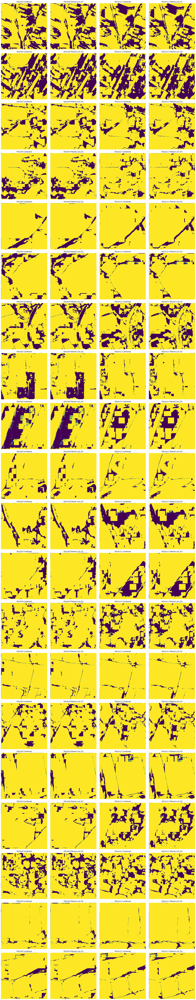

In [12]:
# Функция для получения объединенного слоя предсказаний
def get_combined_layer(model, image_path, threshold=0.25):
    # Получение предсказаний модели
    results = model.predict(source=image_path, save=False, conf=0.0)  # Устанавливаем conf=0.0 для получения всех предсказаний
    masks = results[0].masks.data.cpu().numpy() if results[0].masks else None
    
    if masks is not None:
        # Объединяем все слои по максимальному значению уверенности
        combined_layer = np.max(masks, axis=0)
        # Применяем фильтр по порогу уверенности
        filtered_layer = np.where(combined_layer >= threshold, combined_layer, 0)
        return combined_layer, filtered_layer
    else:
        return None, None

# Визуализация предсказаний
fig, axes = plt.subplots(20, 4, figsize=(20, 100))

for i, image_file in enumerate(image_files):
    image_path = os.path.join(test_images_dir, image_file)
    
    # Обработка для YOLOv8
    combined_v8, filtered_v8 = get_combined_layer(model_v8, image_path)
    
    # Обработка для YOLOv11
    combined_v11, filtered_v11 = get_combined_layer(model_v11, image_path)
    
    # Отображение результатов для YOLOv8
    if combined_v8 is not None:
        axes[i, 0].imshow(combined_v8, cmap='viridis')
        axes[i, 0].set_title(f"YOLOv8 Combined")
        axes[i, 0].axis("off")
        
        axes[i, 1].imshow(filtered_v8, cmap='viridis')
        axes[i, 1].set_title(f"YOLOv8 Filtered (≥0.25)")
        axes[i, 1].axis("off")
    
    # Отображение результатов для YOLOv11
    if combined_v11 is not None:
        axes[i, 2].imshow(combined_v11, cmap='viridis')
        axes[i, 2].set_title(f"YOLOv11 Combined")
        axes[i, 2].axis("off")
        
        axes[i, 3].imshow(filtered_v11, cmap='viridis')
        axes[i, 3].set_title(f"YOLOv11 Filtered (≥0.25)")
        axes[i, 3].axis("off")

plt.tight_layout()
plt.savefig('combined.pdf', 
            format='pdf',
            bbox_inches='tight',
            dpi=300)
plt.show()


**Сравнение:**

Характер распознавания:

1. YOLOv8 лучше определяет протяженные и связанные сельскохозяйственные территории
2. YOLOv11 более точно выделяет геометрически правильные формы полей
3. Обе модели хорошо определяют линейные структуры (например, длинные узкие поля)

Применение:
- Для общей оценки территории я бы предпочел YOLOv8
- Для точного определения границ отдельных участков лучше взять YOLOv11